# Debug exploration of (SwissInfo) WW2 Radio Bulletins

This notebook aims to perform a first rougth exploration of the the data at hand, for the KB and SwissInfo radio bulletins.



### Imports

In [50]:
import os
import requests
from bs4 import BeautifulSoup
#from pypdf import PdfReader
import json
#import pdfplumber
from PIL import Image, ImageDraw, ImageFont
import pymupdf
from pdf2image import convert_from_path
import fitz 
from copy import deepcopy
import pymupdf
from datetime import datetime

### Functions

In [2]:
def coords_to_xy(coords):
    # turns (x,y,w,h) coordinates into (x1, y1, x2, y2) coordinates
    return [coords[0], coords[1], coords[0]+coords[2], coords[1]+coords[3]]

In [3]:
def rescale_xy_coords(xy_coods, curr_size, dest_size):
    x_sc_factor = dest_size[0]/curr_size[0]
    y_sc_factor = dest_size[1]/curr_size[1]
    return [c*x_sc_factor if idx%2==0 else c*y_sc_factor for idx, c in enumerate(xy_coods)]

In [4]:
def draw_box_on_img(base_img_path, coords_xy, img = None, width=10, text = None, color='red'):
    if not img:
        img = Image.open(base_img_path)  
    img_draw = ImageDraw.Draw(img)
    img_draw.rectangle(coords_xy, outline=color, width=width)

    if text is not None: 
        img_draw.text((coords_xy[0], coords_xy[1]),text,(0,0,0))
    return img

In [5]:
def scale_wh_coords(coords, curr_res, des_res):
    return [c*int(des_res)/int(curr_res) for c in coords]

In [6]:
def rescale_coords(
    coords: list[float], 
    curr_size: tuple[float, float] = None, 
    dest_size: tuple[float, float] = None, 
    curr_res: float = None, 
    dest_res: float = None,
    xy_format: bool = True, 
    int_sc_factor: bool = False
) -> list[float]:
    """Scales image or bounding box coordinates based on image size or resolution.

    This function rescales a set of coordinates (`coords`) based on either:
    - The current and target image sizes (`curr_size` and `dest_size`).
    - The current and target resolutions (`curr_res` and `dest_res`).
    
    If `xy_format` is False and `curr_res`/`dest_res` are not provided, the function 
    estimates a resolution-based scaling factor using image sizes (`width * height`).

    When `xy_format` is True, the function assumes coordinates are in "x1, y1, x2, y2" format.
    Otherwise, it assumes "x, y, width, height" format.

    Args:
        coords (list[float]): List of coordinates to be scaled.
        curr_size (tuple[float, float], optional): Current image size (width, height).
            Required if `xy_format=True`. Defaults to None.
        dest_size (tuple[float, float], optional): Target image size (width, height).
            Required if `xy_format=True`. Defaults to None.
        curr_res (float, optional): Current image resolution (optional for `xy_format=False`).
        dest_res (float, optional): Target image resolution (optional for `xy_format=False`).
        xy_format (bool, optional): If True, treats coordinates as "x1, y1, x2, y2".
            If False, treats coordinates as "x, y, width, height". Defaults to True.
        int_sc_factor (bool, optional): If True, scales using integer division for factor calculation. 
            Defaults to False.

    Returns:
        list[float]: Scaled coordinates.

    Raises:
        ValueError: If required parameters (size or resolution) are missing.
        ValueError: If `curr_size` or `curr_res` contain zero.

    Example:
        >>> scale_coords([10, 20, 30, 40], (100, 200), (200, 400))
        [20.0, 40.0, 60.0, 80.0]
    """  
    # Validate input parameters
    if xy_format:
        if curr_size is None or dest_size is None:
            raise ValueError("When `xy_format` is True, `curr_size` and `dest_size` must be provided.")
        if 0 in curr_size:
            raise ValueError("Current image size must be non-zero values.")
    else:
        if curr_res is None or dest_res is None:
            if curr_size is None or dest_size is None:
                raise ValueError("When `xy_format` is False, either (`curr_res` and `dest_res`) or (`curr_size` and `dest_size`) must be provided.")
            # Estimate resolution from image size
            curr_res = curr_size[0] * curr_size[1]
            dest_res = dest_size[0] * dest_size[1]
        if curr_res == 0:
            raise ValueError("Current image resolution or size must be non-zero values.")

    # Compute scaling factors
    if xy_format:
        x_scale = int(dest_size[0]) / int(curr_size[0]) if int_sc_factor else dest_size[0] / curr_size[0]
        y_scale = int(dest_size[1]) / int(curr_size[1]) if int_sc_factor else dest_size[1] / curr_size[1]

        return [c * (x_scale if i % 2 == 0 else y_scale) for i, c in enumerate(coords)]
    else:
        scale_factor = int(dest_res) / int(curr_res) if int_sc_factor else dest_res / curr_res

        return [c * scale_factor for c in coords]

## SwissInfo WWII Bulletins - Text-embedded PDFs

SwissInfo's OCR data is already contained within the PDF files. 
In order to process them, we first need extract it in XML or any other format that we know how to work with.

In [7]:
swissinfo_data_path = "/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/"
si_ocr_data_path = os.path.join(swissinfo_data_path, 'ww2-PDF')
si_excel_path = os.path.join(swissinfo_data_path, 'SWI_Konkordanz_pdf-neu.xlsx')

si_ocr_data_path

'/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF'

In [8]:
swissinfo_filenames = os.listdir(si_ocr_data_path)
swissinfo_filenames[:5]

['SRI_XY_CJ_19450712_FR.pdf',
 'SRI_XY_CJ_19410312_FR.pdf',
 'SRI_XY_CJ_19440307_FR.pdf',
 'SRI_XY_CJ_19410322_DE.pdf',
 'SRI_XY_CJ_19451023_FR.pdf']

## Playing around with various OCR text extraction libraries

In [9]:
test_img_path = os.path.join(si_ocr_data_path, swissinfo_filenames[0])
test_img_path

'/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF/SRI_XY_CJ_19450712_FR.pdf'

### 1. pypdf

In [7]:
reader = PdfReader(test_img_path)
number_of_pages = len(reader.pages)
page = reader.pages[0]
text = page.extract_text()

number_of_pages

2

In [8]:
page

{'/Type': '/Page',
 '/MediaBox': [0, 0, 610.08, 849.36],
 '/Resources': {'/XObject': {'/Im001': {'/Subtype': '/Image',
    '/Width': 1,
    '/Height': 1,
    '/ColorSpace': '/DeviceGray',
    '/BitsPerComponent': 8,
    '/OC': {'/Type': '/OCMD',
     '/OCGs': [IndirectObject(20, 0, 139836059727504)],
     '/P': '/AllOff'}},
   '/Im002': {'/Subtype': '/Image',
    '/Width': 1271,
    '/Height': 1770,
    '/ColorSpace': '/DeviceRGB',
    '/BitsPerComponent': 8,
    '/Interpolate': True,
    '/OC': {'/Type': '/OCG', '/Name': 'Background'},
    '/Filter': '/JPXDecode'},
   '/Im003': {'/Subtype': '/Image',
    '/Width': 848,
    '/Height': 1180,
    '/ColorSpace': '/DeviceRGB',
    '/BitsPerComponent': 8,
    '/SMask': {'/Subtype': '/Image',
     '/Width': 2542,
     '/Height': 3539,
     '/ColorSpace': '/DeviceGray',
     '/BitsPerComponent': 1,
     '/Decode': [1, 0],
     '/Interpolate': True,
     '/Filter': '/JBIG2Decode'},
    '/OC': {'/Type': '/OCG', '/Name': 'Text Color'},
    '/Fil

In [9]:
print(text)

Chronique de la journée.       12 juillet 1945. Seitz. 
Mesdames et Messieurs, 
Veuillez écouter notre chronique de la journée. 
Le ministèèe des affaires étrangères de Grande-Bretagne a remis 
au Quai d'Orsay une note proposant que la conférence de Tanger soit 
ajournée jusque ce que le gouvernement britannique ait pu examiner la 
question de la participation soviétique» 
les adminsitrations militaires Kfe britannique et américaine assume- 
ront dès aujourd'hui la charge d'environ 1.650.000 Berlinois à la suite 
de l'accord intervenu à la commission interalliée, ^es décisions de 
celle-ci ont été prises à l'unanimité. Les experts alliés prôparsHKfexent 
un plan pour assurer la ravitaillement en vivres de la population. Tant 
que les moyens de transport ne seront pas améliorés dans les zÈnes an- 
glaise et américaine d'occupation, les Russes contribueront à participer 
au ravitaillement des habitants de ces zones. Une réunion devait se 
dérouler aujourd'hui pour examiner la politique à

#### Comments

- Good thing is that text is already rebuilt and formatted perfectly. 
- It would be necessary to look more at the documentation to know exactly how to interpret and extract information from the pages object.
- However, it does seem like we are loosing coordinates/placement information which could be problematic. 
- To be considered further, also trying out other similar tools

### 2. [pdfplumber](https://github.com/jsvine/pdfplumber)

In [10]:
with pdfplumber.open(test_img_path) as pdf:
    for page in pdf.pages:
        print(page.extract_text())

Chronique de la journée. 12 juillet 1945. Seitz.
Mesdames et Messieurs,
Veuillez écouter notre chronique de la journée.
Le ministèèe des affaires étrangères de Grande-Bretagne a remis
au Quai d'Orsay une note proposant que la conférence de Tanger soit
ajournée jusque ce que le gouvernement britannique ait pu examiner la
question de la participation soviétique»
les adminsitrations militaires Kfe britannique et américaine assume-
ront dès aujourd'hui la charge d'environ 1.650.000 Berlinois à la suite
de l'accord intervenu à la commission interalliée, ^es décisions de
celle-ci ont été prises à l'unanimité. Les experts alliés prôparsHKfexent
un plan pour assurer la ravitaillement en vivres de la population. Tant
que les moyens de transport ne seront pas améliorés dans les zÈnes an-
glaise et américaine d'occupation, les Russes contribueront à participer
au ravitaillement des habitants de ces zones. Une réunion devait se
dérouler aujourd'hui pour examiner la politique à suivre en matière de

In [11]:
with pdfplumber.open(test_img_path) as pdf:
    first_page = pdf.pages[0]
    print(first_page)
    print(first_page.chars[0])

<Page:1>
{'matrix': (610.08, 0.0, 0.0, 849.36, 32212.224000000002, 691650.8352000001), 'fontname': 'Courier', 'adv': 7.066799999999999, 'upright': True, 'x0': 32212.224000000002, 'y0': 689508.7492800001, 'x1': 36523.537344000004, 'y1': 700550.42928, 'width': 4311.313344000002, 'height': 11041.679999999935, 'size': 11041.679999999935, 'mcid': None, 'tag': None, 'object_type': 'char', 'page_number': 1, 'ncs': 'DeviceGray', 'text': 'C', 'stroking_color': None, 'stroking_pattern': None, 'non_stroking_color': None, 'non_stroking_pattern': None, 'top': -699701.06928, 'bottom': -688659.3892800001, 'doctop': -699701.06928}


This library seems to specifically have also a command-line interface

In [12]:
! pdfplumber < /mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF/SRI_XY_CJ_19450712_FR.pdf > SRI_XY_CJ_19450712_FR_test.json --format json

In [13]:
txt_lines = []
with pdfplumber.open(test_img_path) as pdf:
    for page in pdf.pages:
        print(page.page_number)
        txt_lines.append(page.extract_text_lines())
        print(page.extract_text_lines())
        print(page.extract_text())

1
[{'text': 'Chronique de la journée. 12 juillet 1945. Seitz.', 'x0': 32212.224000000002, 'top': -699701.06928, 'x1': 316411.282462176, 'bottom': -688659.3892800001, 'chars': [{'matrix': (610.08, 0.0, 0.0, 849.36, 32212.224000000002, 691650.8352000001), 'fontname': 'Courier', 'adv': 7.066799999999999, 'upright': True, 'x0': 32212.224000000002, 'y0': 689508.7492800001, 'x1': 36523.537344000004, 'y1': 700550.42928, 'width': 4311.313344000002, 'height': 11041.679999999935, 'size': 11041.679999999935, 'mcid': None, 'tag': None, 'object_type': 'char', 'page_number': 1, 'ncs': 'DeviceGray', 'text': 'C', 'stroking_color': None, 'stroking_pattern': None, 'non_stroking_color': None, 'non_stroking_pattern': None, 'top': -699701.06928, 'bottom': -688659.3892800001, 'doctop': -699701.06928}, {'matrix': (610.08, 0.0, 0.0, 849.36, 36523.537344000004, 691650.8352000001), 'fontname': 'Courier', 'adv': 7.066799999999999, 'upright': True, 'x0': 36523.537344000004, 'y0': 689508.7492800001, 'x1': 40834.85

In [14]:
txt_lines

[[{'text': 'Chronique de la journée. 12 juillet 1945. Seitz.',
   'x0': 32212.224000000002,
   'top': -699701.06928,
   'x1': 316411.282462176,
   'bottom': -688659.3892800001,
   'chars': [{'matrix': (610.08,
      0.0,
      0.0,
      849.36,
      32212.224000000002,
      691650.8352000001),
     'fontname': 'Courier',
     'adv': 7.066799999999999,
     'upright': True,
     'x0': 32212.224000000002,
     'y0': 689508.7492800001,
     'x1': 36523.537344000004,
     'y1': 700550.42928,
     'width': 4311.313344000002,
     'height': 11041.679999999935,
     'size': 11041.679999999935,
     'mcid': None,
     'tag': None,
     'object_type': 'char',
     'page_number': 1,
     'ncs': 'DeviceGray',
     'text': 'C',
     'stroking_color': None,
     'stroking_pattern': None,
     'non_stroking_color': None,
     'non_stroking_pattern': None,
     'top': -699701.06928,
     'bottom': -688659.3892800001,
     'doctop': -699701.06928},
    {'matrix': (610.08,
      0.0,
      0.0,
    

In [15]:
pdf.pages[0].height, pdf.pages[0].width

(849.36, 610.08)

In [17]:
pdf.draw_line(first_l, stroke_width=1)

AttributeError: 'PDF' object has no attribute 'draw_line'

In [14]:
first_l = txt_lines[0][0]
coords_xy_first_line = [int(first_l['x0']), int(first_l['top']), int(first_l['x1']), int(first_l['bottom'])]

img = convert_from_path(test_img_path)
img

[<PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1695x2360>,
 <PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1686x2351>]

In [ ]:
draw_box_on_img(test_img_path, coords_xy_first_line, img[0])

#### Comments

- There seems to be more information, and in particular the lines and tokens whiche are nice
- However the coordinates seem very weird and their [`draw_line`](https://github.com/jsvine/pdfplumber?tab=readme-ov-file#drawing-methods) method does not seem to work
- documentation is limited, it would need further explorations

### 2. [PyMuPDF](https://pypi.org/project/PyMuPDF/) (fitz)

In [10]:
doc = fitz.open(test_img_path)

block_with_lines = {}
# Extract text and bounding boxes from each page
for page_number in range(len(doc)):
    page = doc.load_page(page_number)  # Load a specific page
    blocks = page.get_text("dict")["blocks"]  # Extract text as a dictionary
    block_with_lines[page_number] = []
    for block in blocks:
        if "lines" in block:
            block_with_lines[page_number].append(block)
            for line in block["lines"]:
                for span in line["spans"]:
                    text = span["text"]  # Extracted text
                    bbox = span["bbox"]  # Bounding box (x0, y0, x1, y1)
                    print(f"Text: {text}, BBox: {bbox}")


Text: Chronique, BBox: (52.79999923706055, 22.92397689819336, 116.4012222290039, 39.16097640991211)
Text:  , BBox: (116.4012222290039, 22.92397689819336, 125.0412826538086, 39.16097640991211)
Text: de, BBox: (125.0412826538086, 22.92397689819336, 137.7615203857422, 39.16097640991211)
Text:  , BBox: (137.7615203857422, 22.92397689819336, 146.40158081054688, 39.16097640991211)
Text: la, BBox: (146.40158081054688, 22.92397689819336, 160.08120727539062, 39.16097640991211)
Text:  , BBox: (160.08120727539062, 22.92397689819336, 168.24156188964844, 39.16097640991211)
Text: journée., BBox: (168.24156188964844, 22.92397689819336, 222.47959899902344, 39.16097640991211)
Text:  , BBox: (222.47959899902344, 22.92397689819336, 230.87942504882812, 39.16097640991211)
Text:       , BBox: (230.87942504882812, 22.92397689819336, 282.7198486328125, 39.16097640991211)
Text: 12, BBox: (282.7198486328125, 22.92397689819336, 296.15924072265625, 39.16097640991211)
Text:  , BBox: (296.15924072265625, 22.9239768

In [11]:
page_1_text = doc.load_page(0).get_text()
page_1_text

"Chronique de la journée.       12 juillet 1945. Seitz. \nMesdames et Messieurs, \nVeuillez écouter notre chronique de la journée. \nLe ministèèe des affaires étrangères de Grande-Bretagne a remis \nau Quai d'Orsay une note proposant que la conférence de Tanger soit \najournée jusque ce que le gouvernement britannique ait pu examiner la \nquestion de la participation soviétique» \nles adminsitrations militaires Kfe britannique et américaine assume- \nront dès aujourd'hui la charge d'environ 1.650.000 Berlinois à la suite \nde l'accord intervenu à la commission interalliée, ^es décisions de \ncelle-ci ont été prises à l'unanimité. Les experts alliés prôparsHKfexent \nun plan pour assurer la ravitaillement en vivres de la population. Tant \nque les moyens de transport ne seront pas améliorés dans les zÈnes an- \nglaise et américaine d'occupation, les Russes contribueront à participer \nau ravitaillement des habitants de ces zones. Une réunion devait se \ndérouler aujourd'hui pour examine

In [12]:
page_1_dict = doc.load_page(0).get_text("dict")
page_1_dict

{'width': 610.0800170898438,
 'height': 849.3599853515625,
 'blocks': [{'number': 0,
   'type': 1,
   'bbox': (0.0, 0.0, 610.0800170898438, 849.3599853515625),
   'width': 1271,
   'height': 1770,
   'ext': 'png',
   'colorspace': 3,
   'xres': 96,
   'yres': 96,
   'bpc': 8,
   'transform': (610.0800170898438, 0.0, -0.0, 849.3599853515625, 0.0, 0.0),
   'size': 1574784,
   'image': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\xf7\x00\x00\x06\xea\x08\x02\x00\x00\x00"\xaf\x02\xf9\x00\x00\x00\tpHYs\x00\x00\x0e\xc4\x00\x00\x0e\xc4\x01\x95+\x0e\x1b\x00\x18\x072IDATx\x9c\xec\xbd\xeb\x92#\xb9\x92\xa07\xef\xff\x06+\x99fe\xb6\xbb?\xa4\x1fz\x01\x99d\xb2\x99\xd5\x8e4\xbb\xb3;\xda3}NwW\xd7=/\xbc\xc4\xfdFf\x92\xcc\x94\x03\x8e\x8b\x03p \x10AfU\x9f\x9e\n\xf3\xcef\x91\xc1 \x02\x018\xfcsw\x00\x7f\xf3\xba\xe2x\x11\xf2r\x01yq\xe5\xf5\xf5\xa2>\x15"\xff)N;\xbf\xf8\x82\xef\x93\x8f.J.R\xd4?\xf1\x9a//V.D\xceB\xd4\x05N\x17*\xafJ\xd49\xafg\xf8\x9dW\xf3\x9b\x17W\xce\x97\x97\xf3\xf9\xe5t\xbe\x08\xb9\xa8\x12

In [13]:
block_with_lines

{0: [{'number': 2,
   'type': 0,
   'bbox': (52.79999923706055,
    21.064977645874023,
    526.4390869140625,
    39.16097640991211),
   'lines': [{'spans': [{'size': 12.373924255371094,
       'flags': 8,
       'bidi': 0,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'alpha': 0,
       'ascender': 0.9319999814033508,
       'descender': -0.31700000166893005,
       'text': 'Chronique',
       'origin': (52.79999923706055, 35.03997802734375),
       'bbox': (52.79999923706055,
        22.92397689819336,
        116.4012222290039,
        39.16097640991211)},
      {'size': 13.68215274810791,
       'flags': 8,
       'bidi': 0,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'alpha': 0,
       'ascender': 0.9319999814033508,
       'descender': -0.31700000166893005,
       'text': ' ',
       'origin': (116.4012222290039, 35.03997802734375),
       'bbox': (116.4012222290039,
        22.92397689819336,
        125.041282653808

In [14]:
first_block = block_with_lines[0][0]#['lines'][0]['spans'][0]
print(first_block)
first_block_bbox = first_block['bbox']

first_word = first_block['lines'][0]['spans'][0]
first_word_bbox = first_word['bbox']
first_word_text = first_word['text']

{'number': 2, 'type': 0, 'bbox': (52.79999923706055, 21.064977645874023, 526.4390869140625, 39.16097640991211), 'lines': [{'spans': [{'size': 12.373924255371094, 'flags': 8, 'bidi': 0, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'alpha': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': 'Chronique', 'origin': (52.79999923706055, 35.03997802734375), 'bbox': (52.79999923706055, 22.92397689819336, 116.4012222290039, 39.16097640991211)}, {'size': 13.68215274810791, 'flags': 8, 'bidi': 0, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'alpha': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': ' ', 'origin': (116.4012222290039, 35.03997802734375), 'bbox': (116.4012222290039, 22.92397689819336, 125.0412826538086, 39.16097640991211)}, {'size': 11.738935470581055, 'flags': 8, 'bidi': 0, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'alpha': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': 'de', 'origin':

In [15]:
thrid_block = block_with_lines[0][2]#['lines'][0]['spans'][0]
print(thrid_block)
thrid_block_bbox = thrid_block['bbox']

rdm_word = thrid_block['lines'][0]['spans'][0]
rdm_word_bbox = rdm_word['bbox']
rdm_word_text = rdm_word['text']

fifth_block = block_with_lines[0][4]#['lines'][0]['spans'][0]
print(fifth_block)
fifth_block_bbox = fifth_block['bbox']

rdm_word_2 = fifth_block['lines'][0]['spans'][0]
rdm_word_2_bbox = rdm_word_2['bbox']
rdm_word_2_text = rdm_word_2['text']

{'number': 4, 'type': 0, 'bbox': (52.79999923706055, 81.24398803710938, 396.60296630859375, 97.48098754882812), 'lines': [{'spans': [{'size': 12.306819915771484, 'flags': 8, 'bidi': 0, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'alpha': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': 'Veuillez', 'origin': (52.79999923706055, 93.3599853515625), 'bbox': (52.79999923706055, 81.24398803710938, 108.72286224365234, 97.48098754882812)}, {'size': 14.2407865524292, 'flags': 8, 'bidi': 0, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'alpha': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': ' ', 'origin': (108.72285461425781, 93.3599853515625), 'bbox': (108.72285461425781, 81.24398803710938, 118.08285522460938, 97.48098754882812)}, {'size': 12.31025218963623, 'flags': 8, 'bidi': 0, 'char_flags': 0, 'font': 'Courier', 'color': 0, 'alpha': 0, 'ascender': 0.9319999814033508, 'descender': -0.31700000166893005, 'text': 'écouter', 'orig

In [16]:
img = convert_from_path(test_img_path, size=(page_1_dict['width'], page_1_dict['height']))

In [17]:
img[0].height, img[0].width

(849, 610)

Chronique
Veuillez
au


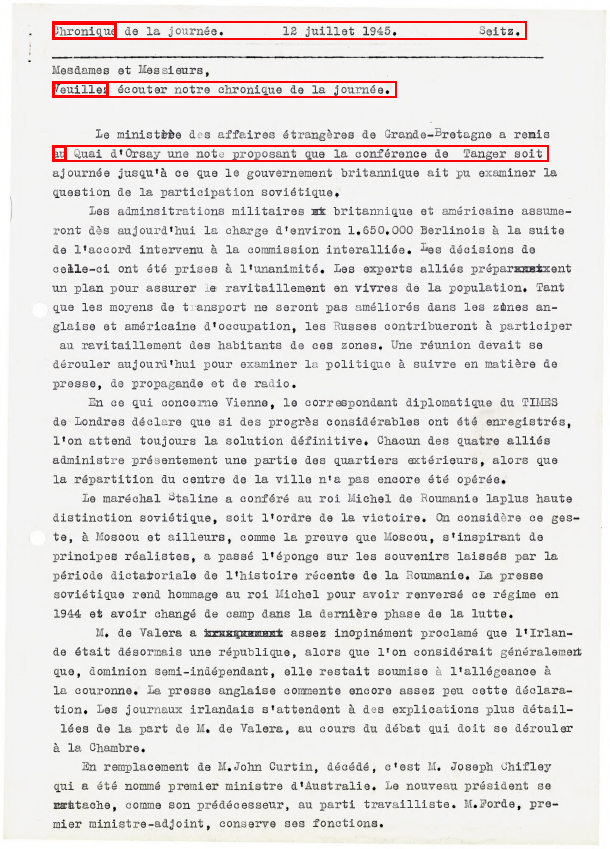

In [18]:
print(first_word_text)
draw_box_on_img(test_img_path, first_block_bbox, img[0], width=2)
draw_box_on_img(test_img_path, first_word_bbox, img[0], width=3)
print(rdm_word_text)
draw_box_on_img(test_img_path, thrid_block_bbox, img[0], width=2)
draw_box_on_img(test_img_path, rdm_word_bbox, img[0], width=3)
print(rdm_word_2_text)
draw_box_on_img(test_img_path, fifth_block_bbox, img[0], width=2)
draw_box_on_img(test_img_path, rdm_word_2_bbox, img[0], width=3)

#### Comments:
- this seems to match our needs much better. 
- It looks like we can extract all coordinates. 
- However, what constitutes a block or a line seems to be a little hard to identify 

In [18]:
with open("test_pdf_out_ocr.json", mode="w") as fout:
    json.dump(page_1_dict, fout)

TypeError: Object of type bytes is not JSON serializable

#### Fetching all blocks

In [46]:
block_with_lines

{0: [{'number': 2,
   'type': 0,
   'bbox': (52.79999923706055,
    21.064977645874023,
    526.4390869140625,
    39.16097640991211),
   'lines': [{'spans': [{'size': 12.373924255371094,
       'flags': 8,
       'bidi': 0,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'alpha': 0,
       'ascender': 0.9319999814033508,
       'descender': -0.31700000166893005,
       'text': 'Chronique',
       'origin': (52.79999923706055, 35.03997802734375),
       'bbox': (52.79999923706055,
        22.92397689819336,
        116.4012222290039,
        39.16097640991211)},
      {'size': 13.68215274810791,
       'flags': 8,
       'bidi': 0,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'alpha': 0,
       'ascender': 0.9319999814033508,
       'descender': -0.31700000166893005,
       'text': ' ',
       'origin': (116.4012222290039, 35.03997802734375),
       'bbox': (116.4012222290039,
        22.92397689819336,
        125.041282653808

In [19]:
blocks_bboxes = {pg: [b['bbox'] for b in pg_blocks] for pg, pg_blocks in block_with_lines.items()}

blocks_f_words = {pg: [b['lines'][0]['spans'][0] for b in pg_blocks] for pg, pg_blocks in block_with_lines.items()}

blocks_f_word_bboxes = {pg: [f_w['bbox'] for f_w in block_f_words] for pg, block_f_words in blocks_f_words.items()}
blocks_f_word_text = {pg: [f_w['text'] for f_w in block_f_words] for pg, block_f_words in blocks_f_words.items()}

In [20]:
print(f"blocks_bboxes: \n {blocks_bboxes} \n")
print(f"blocks_f_words: \n {blocks_f_words} \n")
print(f"blocks_f_word_bboxes: \n {blocks_f_word_bboxes} \n")
print(f"blocks_f_word_text: \n {blocks_f_word_text} \n")

blocks_bboxes: 
 {0: [(52.79999923706055, 21.064977645874023, 526.4390869140625, 39.16097640991211), (51.84000015258789, 62.04397201538086, 216.5970458984375, 78.28097534179688), (52.79999923706055, 81.24398803710938, 396.60296630859375, 97.48098754882812), (95.76000213623047, 126.12399291992188, 556.4382934570312, 142.36099243164062), (52.560001373291016, 145.32400512695312, 548.9979858398438, 161.56100463867188), (52.79999923706055, 164.52401733398438, 564.3551635742188, 180.76101684570312), (53.279998779296875, 183.96395874023438, 346.1996154785156, 200.20095825195312), (89.27999877929688, 202.68399047851562, 578.5194091796875, 218.92098999023438), (53.279998779296875, 222.12399291992188, 571.0814819335938, 238.36099243164062), (53.040000915527344, 241.08401489257812, 542.0486450195312, 257.3210144042969), (53.279998779296875, 260.0439758300781, 578.04541015625, 276.2809753417969), (52.08000183105469, 279.4839782714844, 570.84228515625, 295.7209777832031), (53.52000045776367, 298.68

In [21]:
img = convert_from_path(test_img_path, size=(page_1_dict['width'], page_1_dict['height']))

In [ ]:
colors = ["red", 'green', 'blue', 'yellow', 'orange']
for pg, block_bboxes in blocks_bboxes.items():
    for block_id, bbox in enumerate(block_bboxes):
        txt = f"block {block_id}"
        print(f"Block {block_id}, first word = {blocks_f_word_text[pg][block_id]}")
        color_id = block_id%len(colors)
        img[0] = draw_box_on_img(test_img_path, bbox, img[0], width=2, text=txt, color=colors[color_id])
    break

img[0]

Indeed, one block here corresponds to one line exactly. 
As a result, we cannot group the various paragraphs into blocks except by using the line offset as information. 
This would be a heuristic, which would likely not hold well with the very varied formats and displays.

## Now implementing the logic turning the PDF into the corresponding JSON and writing them to file

There are a few things to do now:
- write the function converting all the pages of a given PDF bulletin to its JSON equivalent, with each page represented.
- Ensure the image bytes can be written to JSON or are removed
- Write the logic writing the resulting JSON files to the correct location on the NAS.
    - The decided location is: `/mnt/impresso_swissinfo_json` which is a rw mount mapping to `/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins-json`, which is itself a ro mount of the NAS.
    Hence, the files written in `/mnt/impresso_swissinfo_json` will be on the NAS and visible in read-only mode from `/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins-json`.


### 1. Ensuring the coordinates work with the larger versions of the images

First we need to ensure we can write a PIL image object to jp2 without any problems

In [ ]:
img[1]

In [22]:
test_sample_dir = "/home/piconti/impresso-text-acquisition/text_preparation/data/sample_data/SWISSINFO"

img_name = test_img_path.split('/')[-1].replace('.pdf', '_p0002.jp2')

full_img_path = os.path.join(test_sample_dir, img_name)
full_img_path

'/home/piconti/impresso-text-acquisition/text_preparation/data/sample_data/SWISSINFO/SRI_XY_CJ_19450712_FR_p0002.jp2'

In [32]:
img[1].save(full_img_path, format='JPEG2000')

In [23]:
large_img = convert_from_path(test_img_path)
large_img_name = test_img_path.split('/')[-1].replace('.pdf', '_large_p0002.jp2')

full_large_img_path = os.path.join(test_sample_dir, large_img_name)
full_large_img_path

'/home/piconti/impresso-text-acquisition/text_preparation/data/sample_data/SWISSINFO/SRI_XY_CJ_19450712_FR_large_p0002.jp2'

In [39]:
large_width, large_height = large_img[0].size
large_width, large_height

(1695, 2360)

In [34]:
large_img[1].save(full_large_img_path, format='JPEG2000')

The larger image has a much better quality. 
The size of the small one is: 610x849
The size of the large one (no width and height provided when reading the pdf) is 1689x2351.

In [ ]:
colors = ["red", 'green', 'blue', 'yellow', 'orange']
for pg, block_bboxes in blocks_bboxes.items():
    for block_id, bbox in enumerate(block_bboxes):
        txt = f"block {block_id}"
        print(f"Block {block_id}, first word = {blocks_f_word_text[pg][block_id]}")
        color_id = block_id%len(colors)
        large_img[0] = draw_box_on_img(test_img_path, bbox, large_img[0], width=2, text=txt, color=colors[color_id])
    break

large_img[0]

The problem however, is that after ALL the coordinates need to be rescaled to fit this larger size. 

We can try doing so with the scale coords function, where curr_res=610x849 and dest_res=1689x2351

In [27]:
large_img[0].size

(1695, 2360)

In [28]:
curr_res = page_1_dict['width']*page_1_dict['height']
dest_res = large_width*large_height

curr_res, dest_res

(518177.5543787107, 4000200)

In [29]:
ratio_small = page_1_dict['width']/page_1_dict['height']
ratio_large = float(large_width)/large_height

ratio_small, ratio_large

(0.7182820330737888, 0.7182203389830508)

In [ ]:
colors = ["red", 'green', 'blue', 'yellow', 'orange']
for pg, block_bboxes in blocks_bboxes.items():
    for block_id, bbox in enumerate(block_bboxes):
        txt = f"block {block_id}"
        print(f"Block {block_id}, first word = {blocks_f_word_text[pg][block_id]}")
        color_id = block_id%len(colors)
        scaled_coords = scale_coords(bbox, curr_res, dest_res)
        large_img[0] = draw_box_on_img(test_img_path, scaled_coords, large_img[0], width=2, text=txt, color=colors[color_id])
    break

large_img[0]

We'll try to rescale both the image and the coords at the same time, to see if it yields better results.

In [ ]:
print(img[0].size)
img[0]

In [ ]:
resized_img0 = img[0].resize((large_width, large_height))
print(resized_img0.size)
resized_img0

In [ ]:
colors = ["red", 'green', 'blue', 'yellow', 'orange']
for pg, block_bboxes in blocks_bboxes.items():
    for block_id, bbox in enumerate(block_bboxes):
        txt = f"block {block_id}"
        print(f"Block {block_id}, first word = {blocks_f_word_text[pg][block_id]}")
        color_id = block_id%len(colors)
        scaled_coords = scale_coords(bbox, curr_res, dest_res)
        large_img = draw_box_on_img(test_img_path, scaled_coords, resized_img0, width=2, text=txt, color=colors[color_id])
    break

large_img

No, it's worse: the image quality is lessened and the coords still don't match. 
There is a problem with the rescaling strategy.

Hence we will stay with the "large image" and try to find a coordinates scaling that works.

In [52]:
first_pg_blocks = blocks_bboxes[0]
first_block_bbox = first_pg_blocks[0]

first_block_bbox

(52.79999923706055, 21.064977645874023, 526.4390869140625, 39.16097640991211)

In [69]:
test_large_img = deepcopy(large_img[0])

In [ ]:
# print original bbox coords in orange
txt_orange = f"block 0, original OCR coords"
print(f"original OCR coords: {first_block_bbox}")
test_large_img = draw_box_on_img(test_img_path, first_block_bbox, test_large_img, width=2, text=txt_orange, color='orange')

# print basic rescaled coords in red 
txt_red = f"block 0, basic rescaled coords"
basic_scaled_coords = scale_coords(first_block_bbox, curr_res, dest_res)
print(f"basic rescaled coords: {basic_scaled_coords}")
test_large_img = draw_box_on_img(test_img_path, basic_scaled_coords, test_large_img, width=3, text=txt_red, color='red')

# print float rescaled coords in blue
txt_blue = f"block 0, float rescaled coords"
float_rescaled_coords = [c*dest_res/curr_res for c in first_block_bbox]
print(f"float rescaled coords: {float_rescaled_coords}")
test_large_img = draw_box_on_img(test_img_path, float_rescaled_coords, test_large_img, width=2, text=txt_blue, color='blue')

# print only two last rescaled coords in yellow
txt_yellow = f"block 0, only two last rescaled coords"
two_last_rescaled_coords = [c*dest_res/curr_res if idx>1 else c for idx, c in enumerate(first_block_bbox)]
print(f"two last rescaled coords: {two_last_rescaled_coords}")
test_large_img = draw_box_on_img(test_img_path, two_last_rescaled_coords, test_large_img, width=2, text=txt_yellow, color='yellow')

# most probably correct option: rescale each x & y based on the correxponding width/height ratio of the images in green
text_green = f"block 0, axis-specific rescaling"
curr_coords_img_size = (page_1_dict['width'],page_1_dict['height'])
axis_spe_rescaled_coords = rescale_xy_coords(first_block_bbox, curr_coords_img_size ,test_large_img.size)
print(f"axis-specific rescaled coords: {two_last_rescaled_coords}")
test_large_img = draw_box_on_img(test_img_path, axis_spe_rescaled_coords, test_large_img, width=2, text=text_green, color='green')


test_large_img

The green rescaling indeed seems to be the correct one, we will validate this by applying it on all bboxes of the page

Block 0, first word = Chronique
Block 1, first word = Mesdames
Block 2, first word = Veuillez
Block 3, first word = Le
Block 4, first word = au
Block 5, first word = ajournée
Block 6, first word = question
Block 7, first word = les
Block 8, first word = ront
Block 9, first word = de
Block 10, first word = celle-ci
Block 11, first word = un
Block 12, first word = que
Block 13, first word = glaise
Block 14, first word = au
Block 15, first word = dérouler
Block 16, first word = presse,
Block 17, first word = En
Block 18, first word = de
Block 19, first word = l'on
Block 20, first word = administre
Block 21, first word = la
Block 22, first word = Le
Block 23, first word = distinction
Block 24, first word = te,
Block 25, first word = principes
Block 26, first word = période
Block 27, first word = soviétique
Block 28, first word = 1944
Block 29, first word = M,
Block 30, first word = de
Block 31, first word = que,
Block 32, first word = la
Block 33, first word = tion.
Block 34, first word = 

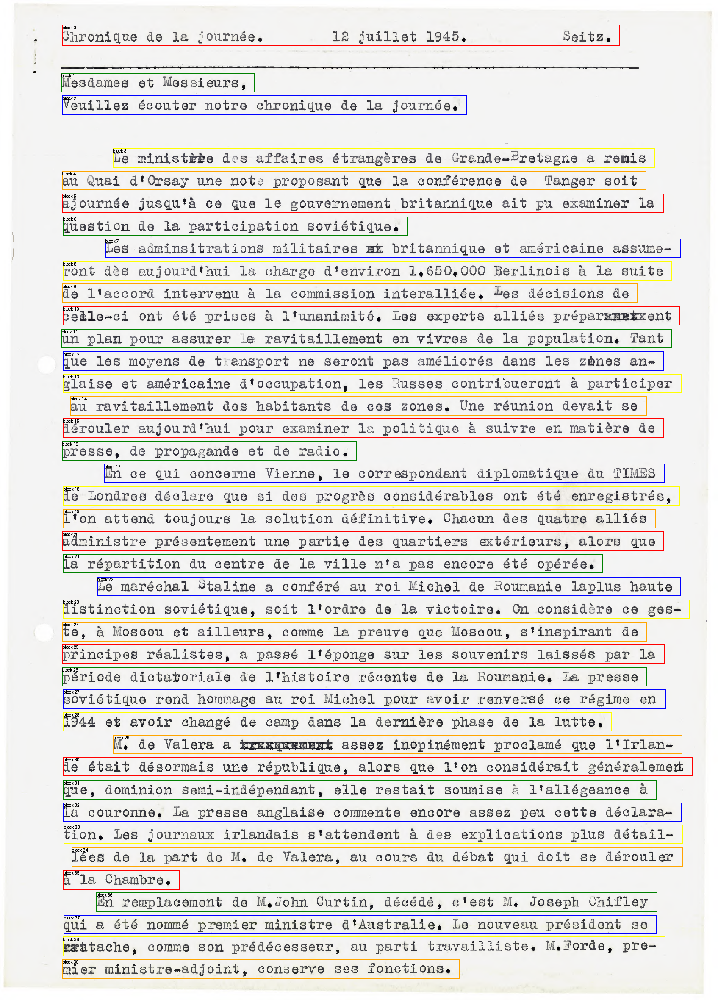

In [78]:
colors = ["red", 'green', 'blue', 'yellow', 'orange']
for pg, block_bboxes in blocks_bboxes.items():
    for block_id, bbox in enumerate(block_bboxes):
        txt = f"block {block_id}"
        print(f"Block {block_id}, first word = {blocks_f_word_text[pg][block_id]}")
        color_id = block_id%len(colors)
        curr_coords_img_size = (page_1_dict['width'],page_1_dict['height'])
        scaled_coords = rescale_coords(bbox, curr_coords_img_size, test_large_img.size)
        test_large_img = draw_box_on_img(test_img_path, scaled_coords, test_large_img, width=2, text=txt, color=colors[color_id])
    break

test_large_img

In [72]:
large_rescaled_img_name = test_img_path.split('/')[-1].replace('.pdf', '_rescaled_p0002.jp2')
full_rescaled_img_path = os.path.join(test_sample_dir, large_rescaled_img_name)
test_large_img.save(full_rescaled_img_path, format='JPEG2000')

This is exactly what we want. 
Now this scaling function needs to be kept and used for all coordinates on the image.


#### Applying the logic to all images


### 2. Writing the function going from the original PDF to the JSON OCR

Here using fitz or pymupdf does not change anything. Since the latest documentation cites rather pymupdf, we will use this.

In [19]:
test_img_path

'/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF/SRI_XY_CJ_19450712_FR.pdf'

In [20]:
large_test_imgs = convert_from_path(test_img_path)
# there are the two pages in PIL format in this list
large_test_imgs

[<PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1695x2360>,
 <PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=1686x2351>]

In [21]:
doc = pymupdf.open(test_img_path)
doc

Document('/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF/SRI_XY_CJ_19450712_FR.pdf')

In [54]:
doc_page0 = doc.load_page(0)

page0_dict = doc_page0.get_text("dict")
blocks = page0_dict['blocks']
blocks_w_lines = [block for block in blocks if "lines" in block]
blocks_wo_lines = [block for block in blocks if "lines" not in block]

blocks_w_lines

[{'number': 2,
  'type': 0,
  'bbox': (52.79999923706055,
   21.064977645874023,
   526.4390869140625,
   39.16097640991211),
  'lines': [{'spans': [{'size': 12.373924255371094,
      'flags': 8,
      'bidi': 0,
      'char_flags': 0,
      'font': 'Courier',
      'color': 0,
      'alpha': 0,
      'ascender': 0.9319999814033508,
      'descender': -0.31700000166893005,
      'text': 'Chronique',
      'origin': (52.79999923706055, 35.03997802734375),
      'bbox': (52.79999923706055,
       22.92397689819336,
       116.4012222290039,
       39.16097640991211)},
     {'size': 13.68215274810791,
      'flags': 8,
      'bidi': 0,
      'char_flags': 0,
      'font': 'Courier',
      'color': 0,
      'alpha': 0,
      'ascender': 0.9319999814033508,
      'descender': -0.31700000166893005,
      'text': ' ',
      'origin': (116.4012222290039, 35.03997802734375),
      'bbox': (116.4012222290039,
       22.92397689819336,
       125.0412826538086,
       39.16097640991211)},
     {'

In [61]:
page0_dict

{'width': 610.0800170898438,
 'height': 849.3599853515625,
 'blocks': [{'number': 0,
   'type': 1,
   'bbox': (0.0, 0.0, 610.0800170898438, 849.3599853515625),
   'width': 1271,
   'height': 1770,
   'ext': 'png',
   'colorspace': 3,
   'xres': 96,
   'yres': 96,
   'bpc': 8,
   'transform': (610.0800170898438, 0.0, -0.0, 849.3599853515625, 0.0, 0.0),
   'size': 1574784,
   'image': b'\x89PNG\r\n\x1a\n\x00\x00\x00\rIHDR\x00\x00\x04\xf7\x00\x00\x06\xea\x08\x02\x00\x00\x00"\xaf\x02\xf9\x00\x00\x00\tpHYs\x00\x00\x0e\xc4\x00\x00\x0e\xc4\x01\x95+\x0e\x1b\x00\x18\x072IDATx\x9c\xec\xbd\xeb\x92#\xb9\x92\xa07\xef\xff\x06+\x99fe\xb6\xbb?\xa4\x1fz\x01\x99d\xb2\x99\xd5\x8e4\xbb\xb3;\xda3}NwW\xd7=/\xbc\xc4\xfdFf\x92\xcc\x94\x03\x8e\x8b\x03p \x10AfU\x9f\x9e\n\xf3\xcef\x91\xc1 \x02\x018\xfcsw\x00\x7f\xf3\xba\xe2x\x11\xf2r\x01yq\xe5\xf5\xf5\xa2>\x15"\xff)N;\xbf\xf8\x82\xef\x93\x8f.J.R\xd4?\xf1\x9a//V.D\xceB\xd4\x05N\x17*\xafJ\xd49\xafg\xf8\x9dW\xf3\x9b\x17W\xce\x97\x97\xf3\xf9\xe5t\xbe\x08\xb9\xa8\x12

In [76]:
page_0_dict_no_img = deepcopy(page0_dict)

for i, b in enumerate(page_0_dict_no_img['blocks']):
    print(f"block {i}, 'lines' inside block: {'lines' in b}")
    if 'image' in b:
        print(f"removing image from block {i}")
        del b['image']
    assert 'image' not in b
    if 'mask' in b:
        print(f"removing mask from block {i}")
        del b['mask']
    assert 'mask' not in b

img

block 0, 'lines' inside block: False
removing image from block 0
removing mask from block 0
block 1, 'lines' inside block: False
removing image from block 1
removing mask from block 1
block 2, 'lines' inside block: True
block 3, 'lines' inside block: True
block 4, 'lines' inside block: True
block 5, 'lines' inside block: True
block 6, 'lines' inside block: True
block 7, 'lines' inside block: True
block 8, 'lines' inside block: True
block 9, 'lines' inside block: True
block 10, 'lines' inside block: True
block 11, 'lines' inside block: True
block 12, 'lines' inside block: True
block 13, 'lines' inside block: True
block 14, 'lines' inside block: True
block 15, 'lines' inside block: True
block 16, 'lines' inside block: True
block 17, 'lines' inside block: True
block 18, 'lines' inside block: True
block 19, 'lines' inside block: True
block 20, 'lines' inside block: True
block 21, 'lines' inside block: True
block 22, 'lines' inside block: True
block 23, 'lines' inside block: True
block 24, 

[<PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=610x849>,
 <PIL.PpmImagePlugin.PpmImageFile image mode=RGB size=610x849>]

In [66]:
page_0_dict_no_img

{'width': 610.0800170898438,
 'height': 849.3599853515625,
 'blocks': [{'number': 0,
   'type': 1,
   'bbox': (0.0, 0.0, 610.0800170898438, 849.3599853515625),
   'width': 1271,
   'height': 1770,
   'ext': 'png',
   'colorspace': 3,
   'xres': 96,
   'yres': 96,
   'bpc': 8,
   'transform': (610.0800170898438, 0.0, -0.0, 849.3599853515625, 0.0, 0.0),
   'size': 1574784},
  {'number': 1,
   'type': 1,
   'bbox': (0.0, 0.0, 610.0800170898438, 849.3599853515625),
   'width': 848,
   'height': 1180,
   'ext': 'png',
   'colorspace': 3,
   'xres': 96,
   'yres': 96,
   'bpc': 8,
   'transform': (610.0800170898438, 0.0, -0.0, 849.3599853515625, 0.0, 0.0),
   'size': 1278043},
  {'number': 2,
   'type': 0,
   'bbox': (52.79999923706055,
    21.064977645874023,
    526.4390869140625,
    39.16097640991211),
   'lines': [{'spans': [{'size': 12.373924255371094,
       'flags': 8,
       'bidi': 0,
       'char_flags': 0,
       'font': 'Courier',
       'color': 0,
       'alpha': 0,
       'as

In [60]:
type(doc_page0.get_text('dict')), type(doc)

(dict, pymupdf.Document)

In [53]:
blocks_wo_lines

blocks_wo_lines_bboxes = {0: [no_line_block['bbox'] for no_line_block in blocks_wo_lines]}
blocks_wo_lines_bboxes

{0: [(0.0, 0.0, 606.9600219726562, 846.239990234375),
  (0.0, 0.0, 606.9600219726562, 846.239990234375)]}

In [ ]:
curr_coords_img_size = (page0_dict['width'], page0_dict['height'])

colors = ["red", 'green', 'blue', 'yellow', 'orange']
for pg, block_bboxes in blocks_wo_lines_bboxes.items():
    for block_id, bbox in enumerate(block_bboxes):
        txt = f"block {block_id}"
        #print(f"Block {block_id}, first word = {blocks_f_word_text[pg][block_id]}")
        color_id = block_id%len(colors)
        scaled_coords = rescale_coords(bbox, curr_coords_img_size, large_test_imgs[0].size)
        large_test_imgs[0] = draw_box_on_img(test_img_path, scaled_coords, large_test_imgs[0], width=2, text=txt, color=colors[color_id])
    break

large_test_imgs[0]

Blocks without lines are simply the bounding box of the almost full image

In [33]:
def remove_key_from_block(block:dict, key:str, page_num:int, block_idx: int) -> dict:
    if key in block:
        msg = f"page {page_num}, removing '{key}' from block {block_idx+1}"
        print(msg)
        #logger.debug(msg)
        del block[key]
    """else:
        msg = f"page {page_num}, '{key}' was not in block {block_idx} and could not be removed."
        print(msg)
        #logger.debug(msg)"""

In [42]:
def rescale_block_coords(block: dict, curr_img_size:tuple[float], dest_img_size:tuple[float]) -> dict:
    if 'bbox' in block:
        block['rescaled_bbox'] = rescale_coords(block['bbox'], curr_img_size, dest_img_size)
        msg = f" - rescaling block bbox."
        print(msg)
        #logger.info(msg)
    if 'lines' in block:
        for l_idx, line in enumerate(block["lines"]):
            if 'bbox' in line:
                line['rescaled_bbox'] = rescale_coords(line['bbox'], curr_img_size, dest_img_size)
                msg = f"    - rescaling line bbox {l_idx+1}/{len(block['lines'])}."
                print(msg)
                #logger.info(msg)
            for s_idx, span in enumerate(line["spans"]):
                if 'bbox' in span:
                    span['rescaled_bbox'] = rescale_coords(span['bbox'], curr_img_size, dest_img_size)
                    msg = f"      - rescaling line {l_idx+1} span bbox {s_idx+1}/{len(line['spans'])}."
                    print(msg)
                    #logger.info(msg)

    return block

In [43]:
def process_blocks_of_page(page_num: int, page_text_dict: dict, page_image_size:tuple[float]) -> dict:
    # create a dict mapping each page number to its blocks, with and without lines

    # first extract the image size that the coordinates correspond to
    curr_ocr_coords_img_size = (page_text_dict['width'], page_text_dict['height'])
    lineless_blocks, blocks_w_lines = [], []
    # iterate over each block
    for i, og_block in enumerate(page_text_dict['blocks']):
        msg = f"Processing block {i+1}/{len(blocks)}:"
        print(msg)
        #logger.info(msg)
        block = deepcopy(og_block)
        #remove the images and masks from the block
        remove_key_from_block(block, 'image', page_num, i)
        remove_key_from_block(block, 'mask', page_num, i)
        # rescale all the bounding boxes inside the block to match the jp2 image size
        block = rescale_block_coords(block, curr_ocr_coords_img_size, page_image_size)
        if "lines" in block:
            blocks_w_lines.append(block)
        else:
            lineless_blocks.append(block)

    # return a dict containing all relevant information extracted for this page
    return {
        "page_num": page_num,
        "ocr_page_size": curr_ocr_coords_img_size,
        "jp2_img_size": page_image_size,
        "blocks_with_lines": blocks_w_lines,
        "blocks_without_lines": lineless_blocks
    }

In [48]:
test_img_path

'/mnt/project_impresso/original/SWISSINFO/WW2-SOC-bulletins/ww2-PDF/SRI_XY_CJ_19450712_FR.pdf'

In [66]:
def get_canonical_path(full_img_path: str, ) -> str:
    # create the canonical path for a given radio bulletin based on its orginal path
    # The canonical path is program/year/month/day/edition/files    

    filename = os.path.basename(test_img_path)
    # all the relevant information is separated by underscores, excluding the extension
    elements = filename.split('.')[0].split('_')

    program = elements[2]
    date = datetime.strptime(elements[3], "%Y%m%d").date()
    lang = elements[4]
    # if the there are more than 5 underscore separated elements, there are multiple editions for this day
    edition = chr (elements[5] + 96) if len(elements) > 5 else "a"
    
    # reconstruct the canonical path
    can_path = os.path.join(f"SOC_{program}", str(date.year), str(date.month).zfill(2), str(date.day).zfill(2), edition)

    return can_path, lang.lower()

In [67]:
get_canonical_path(test_img_path)

('SOC_CJ/1945/07/12/a', 'fr')

In [77]:
def save_as_jp2(pil_imgs:Image, canonical_path:str, out_base_dir: str) -> str:
    canonical_issue_id = canonical_path.replace('/', '-')
    # define the full image out paths with their canonical page IDs from the current canonical issue ID for a given bulletin
    full_out_paths = [os.path.join(out_base_dir, "images", canonical_path, f"{canonical_issue_id}-p{str(i+1).zfill(4)}.jp2") for i in range(len(pil_imgs))]

    success = True
    try:
        for out_path, img in zip(full_out_paths, pil_imgs):
            msg = f"{os.path.basename(out_path)}: Saving image as JP2000 at path {out_path}"
            print(msg)
            #logger.info(msg)
            os.makedirs(os.path.dirname(out_path), exist_ok=True)
            img.save(out_path, format='JPEG2000')
    except Exception as e:
        msg = f"{canonical_issue_id}: There was an exception when trying to save the image as JP2000!! Exception: {e}"
        print(msg)
        #logger.warning(msg)
        success = False

    return full_out_paths, success

In [82]:
def pdf_to_jp2_and_ocr_json(img_path: str, out_base_dir: str = "/mnt/impresso_swissinfo_json") -> tuple[str, bool]:
    # From the original image path:
    # 1. define the canonical path and id
    # 2. convert the pdf image to jp2
    # 3. process pages to extract the OCR and write them to a JSON
    # 4. return the ID and whether the conversion was successful

    canonical_path, lang = get_canonical_path(img_path)
    canonical_issue_id = canonical_path.replace("/", '-')
    
    full_json_out_path = os.path.join(out_base_dir, canonical_path, f"{canonical_issue_id}.json")

    # Not reprocessing bulletins that were already processed
    if os.path.exists(full_json_out_path):
        msg = f"{canonical_issue_id} - The JSON file corresponding to {img_path} already exists, it will not be processed again!"
        print(msg)
        #logger.info(msg)
        return canonical_issue_id, True

    pil_img = convert_from_path(img_path)
    jp2_full_paths, jp2_success = save_as_jp2(pil_img, canonical_path, out_base_dir)

    # create the JSON only if the images could be converted to always ensure both files exist
    if not jp2_success:
        msg = f"{canonical_issue_id} - {img_path}: There was a problem saving the JP2000 version of the images!! Not processing it into a JSON"
        print(msg)
        #logger.warning(msg)
        return canonical_issue_id, False

    ocr_json = {
        "canonical_id": canonical_issue_id,
        "lang": lang, 
        "original_path": img_path, 
        "jp2_full_paths": jp2_full_paths
    }

    doc = pymupdf.open(img_path)
    # iterate over all pages and process its blocks:
    # - removing the images/masks
    # - rescaling the bounding boxes
    processed_pages = []
    for page_num in range(len(doc)):
        print(f"\n** PAGE {page_num} **")
        page = doc.load_page(page_num)
        page_dict = page.get_text('dict')
        processed_pages.append(process_blocks_of_page(page_num, page_dict, pil_img[page_num].size))

    ocr_json["ocr_pages"] = processed_pages

    # Allow a tracking of what images were successfully converted or not
    try:
        # save the resulting OCR JSON to disk:
        os.makedirs(os.path.dirname(full_json_out_path), exist_ok=True)
        with open(full_json_out_path, mode="w") as fout:
            json.dump(ocr_json, fout)

        return canonical_issue_id, True
    except Exception as e:
        msg = f"{canonical_issue_id}: There was an exception when writing the OCR JSON of {img_path}!! Exception: {e}"
        print(msg)
        #logger.warning(msg)
        return canonical_issue_id, False
        

In [83]:
test_canonical_issue_id, success = pdf_to_jp2_and_ocr_json(test_img_path)
test_canonical_issue_id, success

SOC_CJ-1945-07-12-a-p0001.jp2: Saving image as JP2000 at path /mnt/impresso_swissinfo_json/images/SOC_CJ/1945/07/12/a/SOC_CJ-1945-07-12-a-p0001.jp2
SOC_CJ-1945-07-12-a-p0002.jp2: Saving image as JP2000 at path /mnt/impresso_swissinfo_json/images/SOC_CJ/1945/07/12/a/SOC_CJ-1945-07-12-a-p0002.jp2

** PAGE 0 **
Processing block 1/42:
page 0, removing 'image' from block 1
page 0, removing 'mask' from block 1
 - rescaling block bbox.
Processing block 2/42:
page 0, removing 'image' from block 2
page 0, removing 'mask' from block 2
 - rescaling block bbox.
Processing block 3/42:
 - rescaling block bbox.
    - rescaling line bbox 1/1.
      - rescaling line 1 span bbox 1/17.
      - rescaling line 1 span bbox 2/17.
      - rescaling line 1 span bbox 3/17.
      - rescaling line 1 span bbox 4/17.
      - rescaling line 1 span bbox 5/17.
      - rescaling line 1 span bbox 6/17.
      - rescaling line 1 span bbox 7/17.
      - rescaling line 1 span bbox 8/17.
      - rescaling line 1 span bbox 9/

('SOC_CJ-1945-07-12-a', True)

In [47]:
processed_pages

[{'page_num': 0,
  'ocr_page_size': (610.0800170898438, 849.3599853515625),
  'jp2_img_size': (1695, 2360),
  'blocks_with_lines': [{'number': 2,
    'type': 0,
    'bbox': (52.79999923706055,
     21.064977645874023,
     526.4390869140625,
     39.16097640991211),
    'lines': [{'spans': [{'size': 12.373924255371094,
        'flags': 8,
        'bidi': 0,
        'char_flags': 0,
        'font': 'Courier',
        'color': 0,
        'alpha': 0,
        'ascender': 0.9319999814033508,
        'descender': -0.31700000166893005,
        'text': 'Chronique',
        'origin': (52.79999923706055, 35.03997802734375),
        'bbox': (52.79999923706055,
         22.92397689819336,
         116.4012222290039,
         39.16097640991211),
        'rescaled_bbox': [146.69550911325447,
         63.695707842115155,
         323.4003182390845,
         108.81122953907304]},
       {'size': 13.68215274810791,
        'flags': 8,
        'bidi': 0,
        'char_flags': 0,
        'font': 'Courier

In [ ]:

pil_img = convert_from_path(test_img_path)

colors = ["red", 'green', 'blue', 'yellow', 'orange']
for pg_num, page in enumerate(processed_pages):
    for block_id, bbox in enumerate(page['blocks_with_lines']):
        txt = f"block {block_id}"
        #print(f"Block {block_id}, first word = {blocks_f_word_text[pg][block_id]}")
        color_id = block_id%len(colors)
        large_test_imgs[0] = draw_box_on_img(test_img_path, scaled_coords, large_test_imgs[0], width=2, text=txt, color=colors[color_id])
    break

large_test_imgs[0]

### 3. Writing the function writing each JSON to disk with the correct path, along with the corresponding jp2 image